# imports and settings

In [1]:
from SEAM.utils import *
import SEAM
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import anndata as ad
import faiss
import sys
import heapq
from math import sqrt

/home/yzy/anaconda3/envs/scaden/lib/python3.7/site-packages/anndata/_core/anndata.py:21: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import RangeIndex
Using TensorFlow backend.


In [2]:
sns.set_style('white')
# font = {'family' : 'normal',
#         'weight' : 'bold',
#         'size'   : 2}

# matplotlib.rc('font', **font)
# matplotlib.rcParams.update({'font.size': 2})

import matplotlib.pyplot as plt

SMALL_SIZE = 8
MEDIUM_SIZE = 10
BIGGER_SIZE = 12

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

# functions

In [3]:
def ij2ind(i,j,rows=256):
    return i+j*rows

In [4]:
def get_adata_pixel(a):
    in_X = a.uns['IMS']
    matters_list = np.array(a.var_names)
    # obs_name = cell_list
    obs_name = map(str,range(in_X.shape[0]))
    g = map(str,matters_list)
    # g = matters_list

    obs = pd.DataFrame(index=obs_name)

    # var_name must be str
    var = pd.DataFrame(index=g)

    adata = ad.AnnData(in_X,  obs=obs,var=var, dtype='float32')
    a_tmp = np.arange(65536)
    a_tmp_sq = a_tmp.reshape(256,256)
    x_list = [np.where(a_tmp_sq==i)[0][0] for i in a_tmp]
    y_list = [np.where(a_tmp_sq==i)[1][0] for i in a_tmp]
    x_list = np.array(x_list)
    y_list = np.array(y_list)
    
    adata.obsm['spatial'] = np.concatenate((x_list.reshape(-1,1),y_list.reshape(-1,1)),axis=1)
#     adata.obs['spatial_x'] = y_list
#     adata.obs['spatial_y'] = x_list
    return adata

In [5]:
# partition IMS as grid
def get_grid_label(grid_sz):
    pixel_label_mat = np.zeros(shape=(256,256))

    # cell_pos and cell_idx both starts with 1

    # grid_sz = 8
    n_grid_per_row = 256/grid_sz
    k=0
    for i in range(256):
        for j in range(256):
            grid_idx_i = np.floor(i/grid_sz)
            grid_idx_j = np.floor(j/grid_sz)
            grid_idx = grid_idx_i+grid_idx_j*n_grid_per_row+1

            pixel_label_mat[i,j] = grid_idx
            k+=1
    return pixel_label_mat


def make_adata_by_pixellabel(a,pixel_label_mat):
    # 已知pixel_label_mat，重构出一个a。这样方便之后的super pixel。要求：从1开始。没mask到的背景为0
    # 先把pixel_label_mat处理成从1开始的连续
    IMS = a.uns['IMS'].copy()
    num_cells = int(pixel_label_mat.max())
    train_x = []
    cell_idx = []
    cell_pos = []
    for i in range(num_cells):
        cur_idx = i+1

        cur_pixels_i,cur_pixels_j = np.where(pixel_label_mat==cur_idx)
        cur_pixels_idx = [ij2ind(cur_pixels_i[k],cur_pixels_j[k]) for k in range(len(cur_pixels_i))]
        cur_train_x = IMS[cur_pixels_idx,:]
        cur_cell_idx = np.array([cur_idx]*len(cur_pixels_i))
        cur_cell_pos = np.array(cur_pixels_idx)+1
        train_x.append(cur_train_x)
        cell_idx.append(cur_cell_idx)
        cell_pos.append(cur_cell_pos)
    train_x = np.concatenate(train_x)
    cell_idx = np.concatenate(cell_idx)
    cell_pos = np.concatenate(cell_pos)

    mean_rep = SEAM.datasets.get_mean_representation(train_x,cell_idx,num_cells)

    obs = np.arange(num_cells).astype('str')
    var = a.var_names
    obs = pd.DataFrame(index=obs)
    var = pd.DataFrame(index=var)
    a_grid = ad.AnnData(mean_rep,obs=obs,var=var)
    a_grid.uns['IMS'] = IMS
    a_grid.uns['cell_idx'] = cell_idx
    a_grid.uns['cell_pos'] = cell_pos
    a_grid.uns['train_x'] = train_x

    return a_grid

In [6]:
1+1

2

# data loading

In [6]:
a = sc.read_h5ad('/home/yzy/projects/SEAM/SEAM_old/data/raw/mouse_liver_raw.h5ad')

In [7]:
pixel_label_mat_16 = get_grid_label(16)
a_grid = make_adata_by_pixellabel(a,pixel_label_mat_16)

# Cut

### get segmented mask and cell position, and write into anndata

In [8]:
a_grid=SEAM.tl.Cut(a_grid)

setting obsm: spatial


## each cell represented as a dot

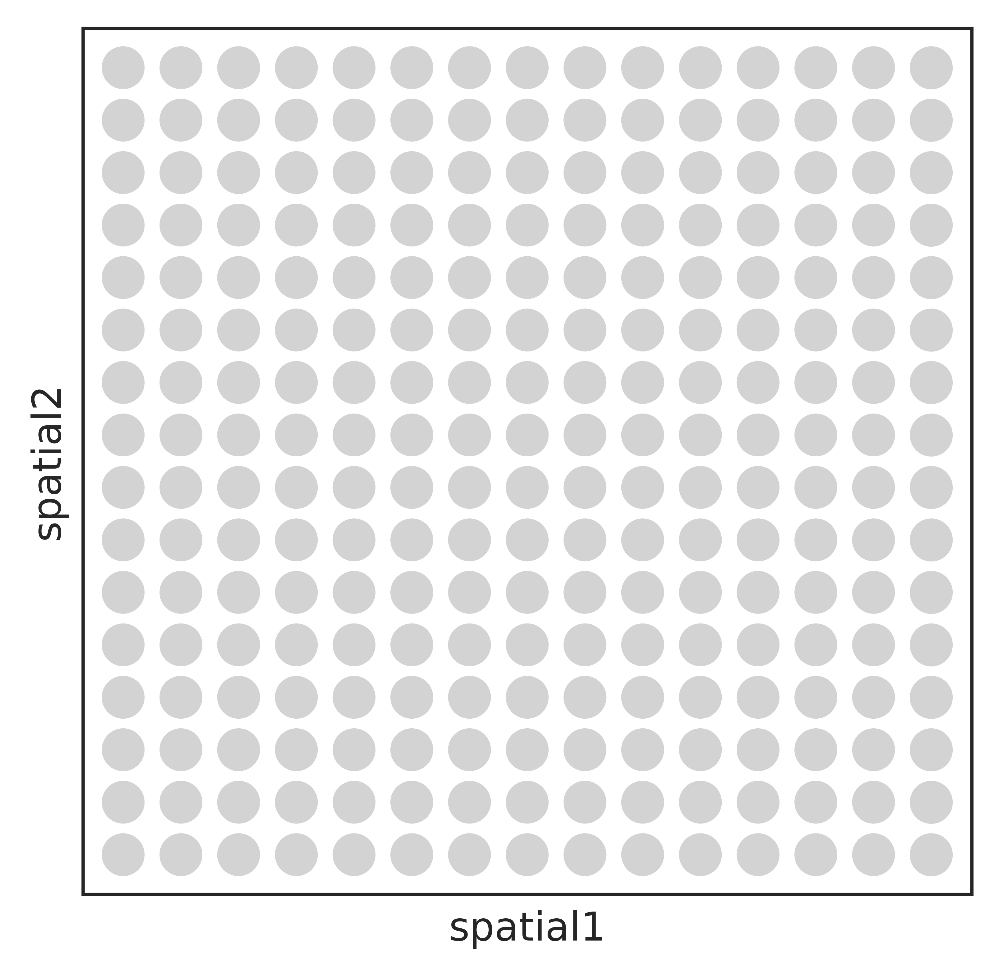

In [10]:
SEAM.pl.Cut(a_grid,method='dot',save=None)

In [20]:
a_grid.obs['grid_no'] = np.arange(256)+1
# a_grid.obs['grid_no'] = a_grid.obs['grid_no'].astype('category')

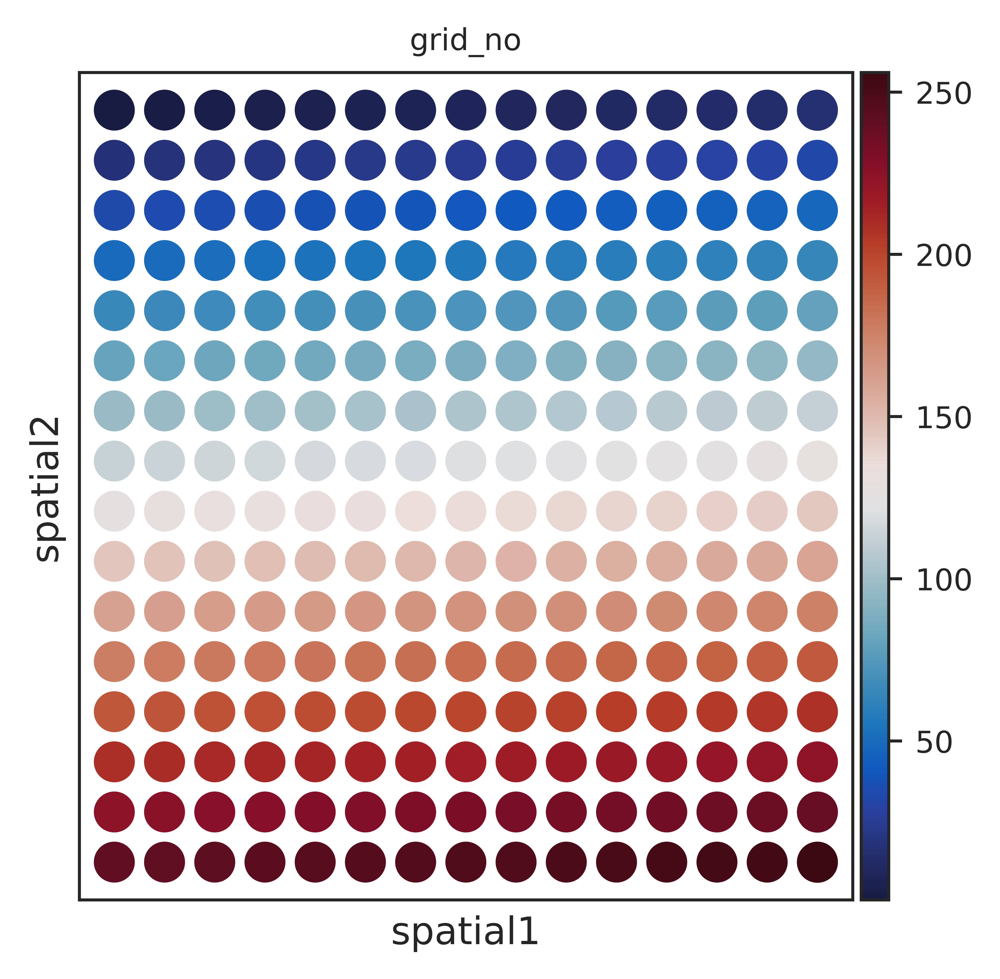

In [23]:
sc.pl.embedding(a_grid,basis='spatial',color='grid_no',cmap=heatmap_cmp)

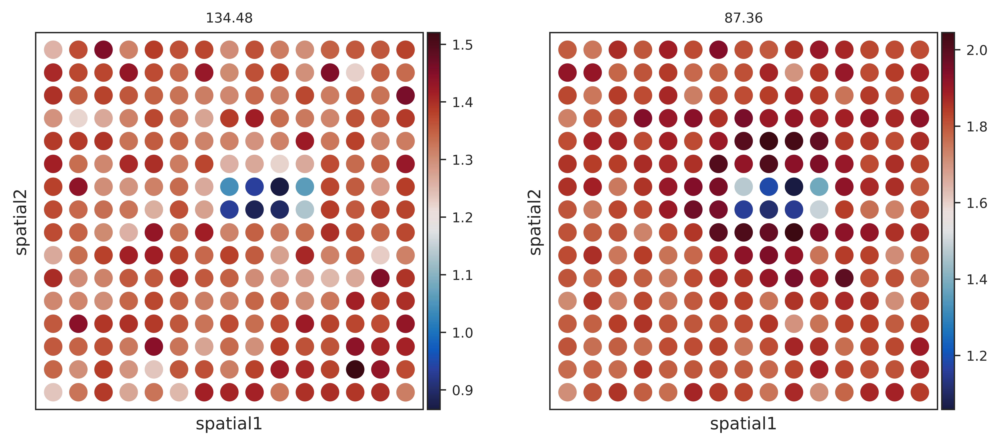

In [26]:
sc.pl.embedding(a_grid,basis='spatial',color=['134.48','87.36'],cmap=heatmap_cmp)

# ID&Cluster

### run SIMS-ID with epochs and temperature.

In [29]:
# a = SEAM.tl.ID(a,epochs=200,t=5,batch_size=1024)
SEAM.tl.ID(a_grid,epochs=10,t=5,subsample=False,verbose=True)

running SIMS-ID...


/home/yzy/anaconda3/envs/scaden/lib/python3.7/site-packages/tensorflow_core/python/framework/indexed_slices.py:424: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


Epoch 1/10
65536/65536 [==============================] - 6s 93us/step - loss: 5.4666 - softmax_loss: 5.4666 - center_loss: 1.7531
Epoch 2/10
65536/65536 [==============================] - 6s 89us/step - loss: 5.4178 - softmax_loss: 5.4178 - center_loss: 3.2021
Epoch 3/10
65536/65536 [==============================] - 6s 98us/step - loss: 5.3646 - softmax_loss: 5.3646 - center_loss: 3.7182
Epoch 4/10
65536/65536 [==============================] - 6s 85us/step - loss: 5.3123 - softmax_loss: 5.3123 - center_loss: 4.5446
Epoch 5/10
65536/65536 [==============================] - 6s 88us/step - loss: 5.2649 - softmax_loss: 5.2649 - center_loss: 5.2454
Epoch 6/10
65536/65536 [==============================] - 6s 87us/step - loss: 5.2333 - softmax_loss: 5.2333 - center_loss: 5.2836
Epoch 7/10
65536/65536 [==============================] - 6s 85us/step - loss: 5.2191 - softmax_loss: 5.2191 - center_loss: 5.1862
Epoch 8/10
65536/65536 [==============================] - 6s 91us/step - loss: 5.20

### dump intermediate results

In [120]:
a.write_h5ad('result/demo_dump/ID_grid8.h5ad')

### dpt

In [53]:
a_grid.uns['iroot'] = 104

In [55]:
sc.pp.neighbors(a_grid,use_rep='ID')
sc.tl.diffmap(a_grid)

computing neighbors
    finished (0:00:00)
computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.96095026 0.945278   0.91198945 0.88734746 0.8781446
     0.8301799  0.8209025  0.80311316 0.7645902  0.7478458  0.73454696
     0.71843344 0.6942041  0.67930216]
    finished (0:00:00)


In [56]:
sc.tl.dpt(a_grid)

computing Diffusion Pseudotime using n_dcs=10
    finished (0:00:00)


In [57]:
np.argmax(a_grid.obs['dpt_pseudotime'])

224

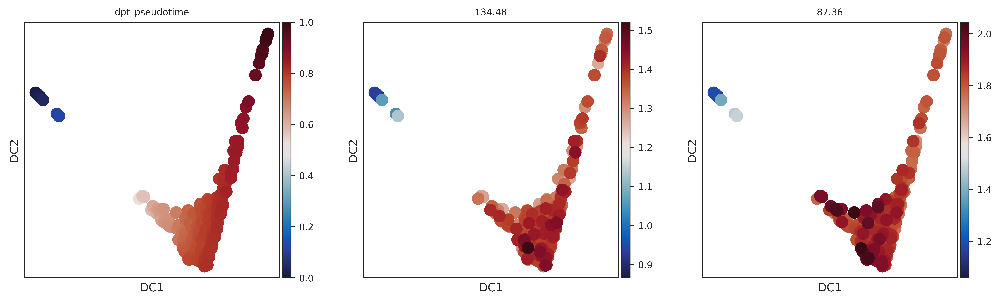

In [58]:
sc.pl.diffmap(a_grid,color=['dpt_pseudotime','134.48','87.36'],ncols=3,cmap=heatmap_cmp)

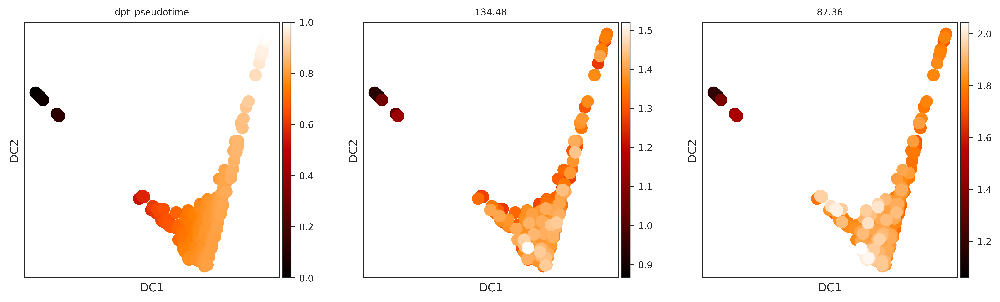

In [81]:
sc.pl.diffmap(a_grid,color=['dpt_pseudotime','134.48','87.36'],ncols=3,cmap='gist_heat')

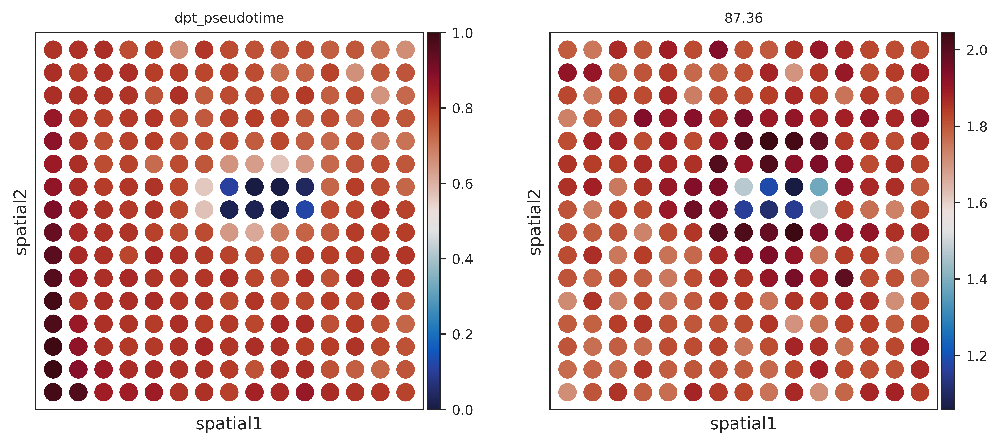

In [59]:
sc.pl.embedding(a_grid,basis='spatial',color=['dpt_pseudotime','87.36'],ncols=3,cmap=heatmap_cmp)

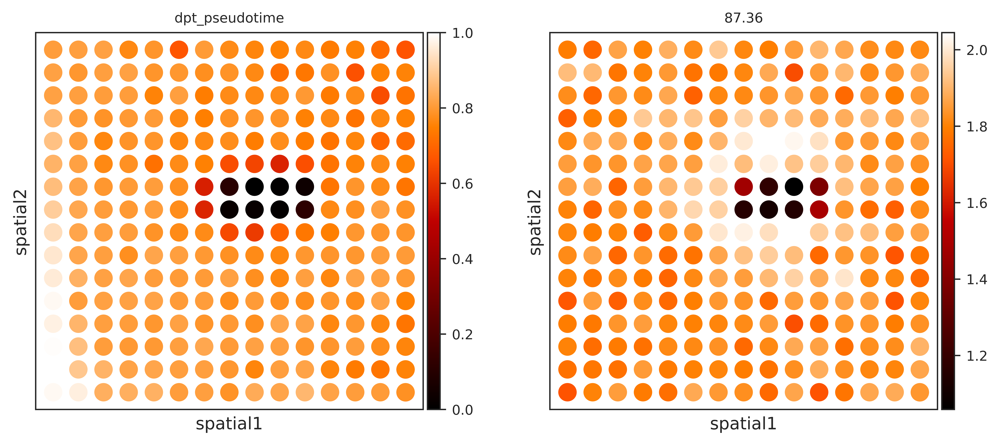

In [82]:
sc.pl.embedding(a_grid,basis='spatial',color=['dpt_pseudotime','87.36'],ncols=3,cmap='gist_heat')

### SIMS-flow global metabolic features

In [60]:
n_dot_row = int(np.sqrt(a_grid.shape[0]))

dpt_mat = np.array(a_grid.obs['dpt_pseudotime'].copy()).reshape(n_dot_row,n_dot_row)
# m = '134.48'
# m = '255.83'
# m = '87.36'
# dpt_mat = np.array(a[:,m].X).reshape(n_dot_row,n_dot_row)
x_mat = a_grid.obsm['spatial'][:,0].reshape(n_dot_row,n_dot_row)
y_mat = a_grid.obsm['spatial'][:,1].reshape(n_dot_row,n_dot_row)
# x_mat = 255-x_mat
# x_mat = np.flipud(x_mat)
# y_mat = np.flipud(y_mat)
dpt_mat = np.flipud(dpt_mat)
# dpt_mat = np.fliplr(dpt_mat)

# y_mat = y_mat.max()-y_mat

In [61]:
dx, dy = np.gradient(dpt_mat)

7.439999999999998

In [67]:
a_grid.obsm['spatial'].max()

247.5625

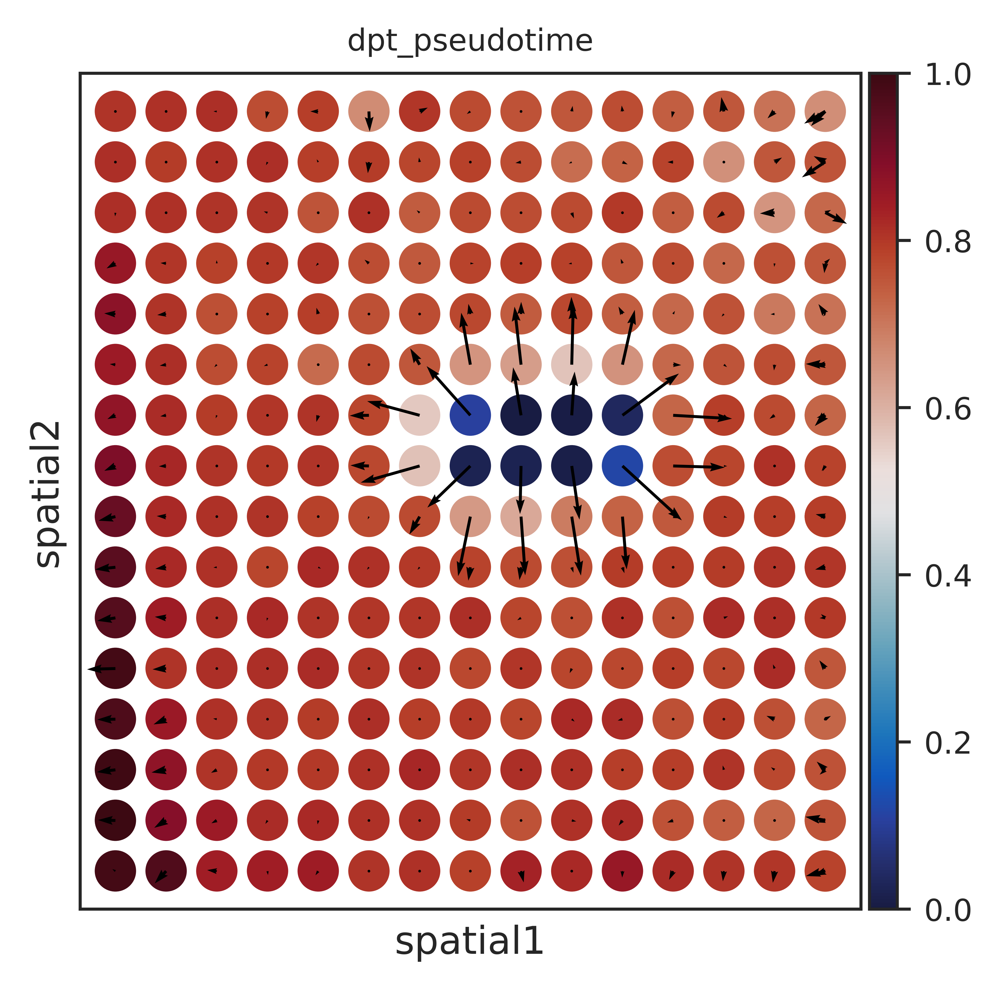

In [71]:
#
# SEAM.settings.heatmap_cmp
ax = sc.pl.embedding(a_grid,basis='spatial',color=['dpt_pseudotime'],show=False,color_map=SEAM.settings.heatmap_cmp)

ax.quiver(x_mat,y_mat-7.5,dy,dx,angles='xy',color='k',scale=5)

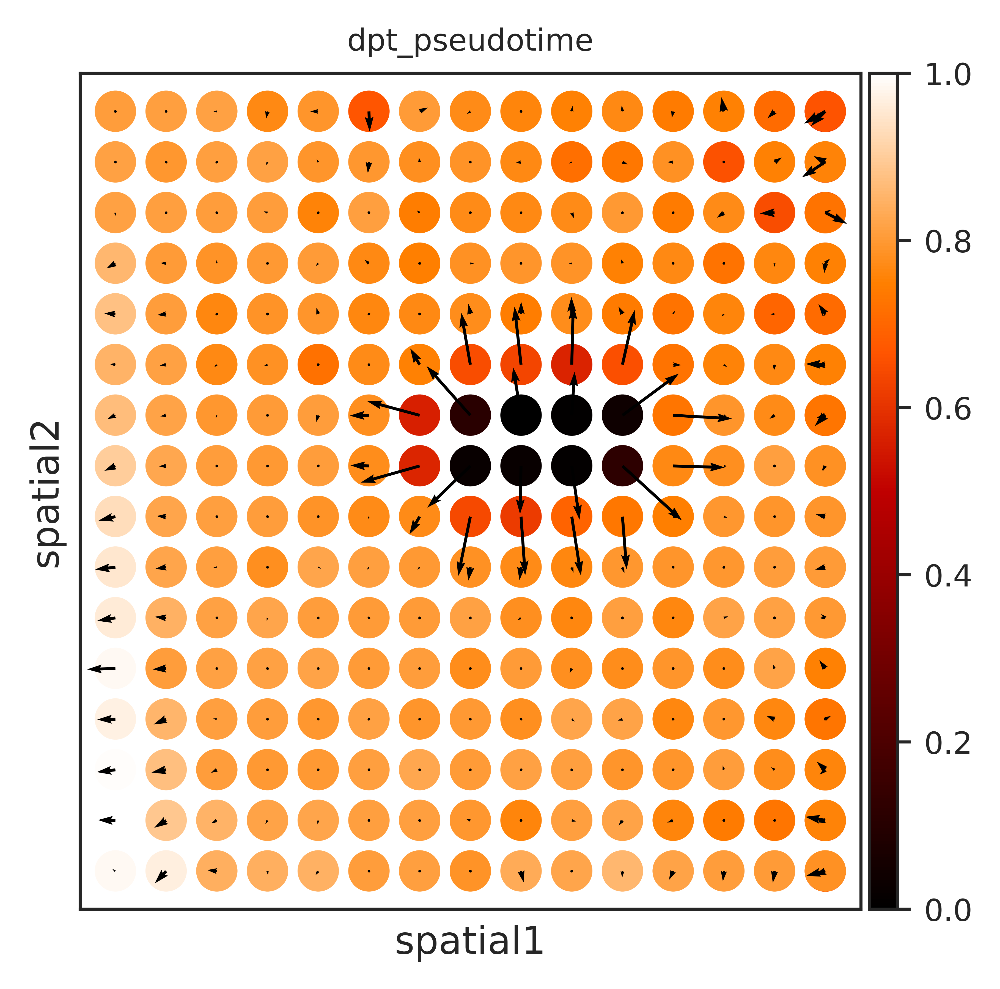

In [83]:
#
# SEAM.settings.heatmap_cmp
ax = sc.pl.embedding(a_grid,basis='spatial',color=['dpt_pseudotime'],show=False,color_map='gist_heat')

ax.quiver(x_mat,y_mat-7.5,dy,dx,angles='xy',color='k',scale=5)

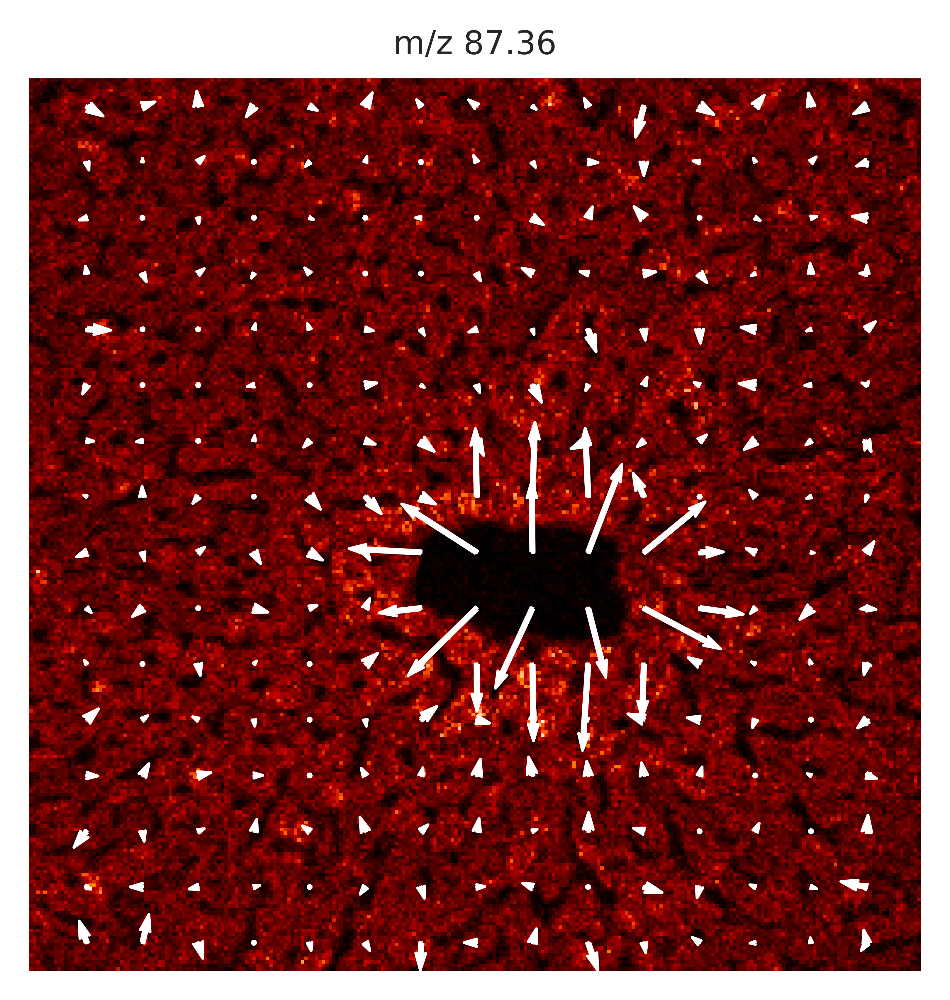

In [77]:
get_flow_by_m('87.36',None)

### define flow function 

In [79]:
def get_flow_by_m(m,save=None):
    n_dot_row = int(np.sqrt(a_grid.shape[0]))

    # dpt_mat = np.array(a.obs['dpt_pseudotime'].copy()).reshape(n_dot_row,n_dot_row)
    # m = '134.48'
    # m = '255.83'
    # m = '87.36'
    
   
    dpt_mat = np.array(a_grid[:,m].X).reshape(n_dot_row,n_dot_row)
    x_mat = a_grid.obsm['spatial'][:,0].reshape(n_dot_row,n_dot_row)
    y_mat = a_grid.obsm['spatial'][:,1].reshape(n_dot_row,n_dot_row)
    # x_mat = 255-x_mat
    # x_mat = np.flipud(x_mat)
    # y_mat = np.flipud(y_mat)
    dpt_mat = np.flipud(dpt_mat)
    # dpt_mat = np.fliplr(dpt_mat)
    dx, dy = np.gradient(dpt_mat)


    cmp_list = 'gist_heat'
    # cmp_list = palettable.colorbrewer.diverging.Spectral_11.mpl_colormap
    # cmp_list = heatmap_cmp
    
    IMS_87 = a.uns['IMS'][:,np.where(a.var_names==m)].reshape(256,256)

    IMS_87_t = np.rot90(IMS_87,2)
    IMS_87_t = np.flip(IMS_87_t,axis=1)

    # ax = sc.pl.embedding(a,basis='spatial',color=['87.36'],show=False,color_map=SEAM.settings.heatmap_cmp)
    fig,ax = plt.subplots(1,1)
    ax.imshow((IMS_87_t),cmap=cmp_list)
    # ax.quiver(x_mat,y_mat,dy,dx,scale=5,color='w')
    # ax.quiver(x_mat,y_mat,dy,dx,angles='xy',color='w',scale=5,width=5)
    ax.quiver(x_mat+7.5,y_mat,dy,dx,angles='xy',color='w',scale=5,linewidths=0.7)
    ax.set_title('m/z '+m)
    ax.axis('off')
    if save is None:
        plt.show()
    else:
        plt.savefig(save,transparent=False,format='png',bbox_inches='tight')

### SIMS-flow selected metabolic features (87.36)

In [10]:
n_dot_row = int(np.sqrt(a_grid.shape[0]))

# dpt_mat = np.array(a.obs['dpt_pseudotime'].copy()).reshape(n_dot_row,n_dot_row)
# m = '134.48'
# m = '255.83'
m = '87.36'
dpt_mat = np.array(a_grid[:,m].X).reshape(n_dot_row,n_dot_row)
x_mat = a_grid.obsm['spatial'][:,0].reshape(n_dot_row,n_dot_row)
y_mat = a_grid.obsm['spatial'][:,1].reshape(n_dot_row,n_dot_row)
# x_mat = 255-x_mat
# x_mat = np.flipud(x_mat)
# y_mat = np.flipud(y_mat)
dpt_mat = np.flipud(dpt_mat)
# dpt_mat = np.fliplr(dpt_mat)
dx, dy = np.gradient(dpt_mat)

# y_mat = y_mat.max()-y_mat

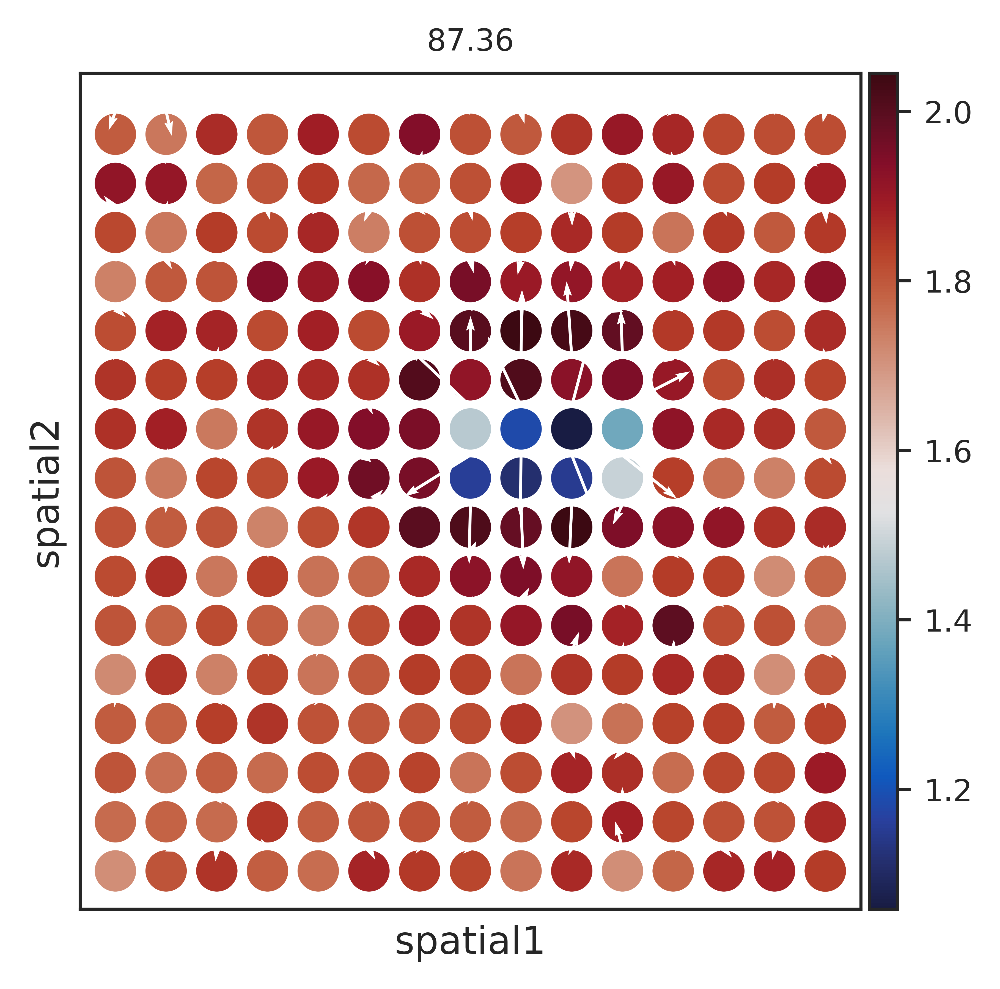

In [11]:
#
# SEAM.settings.heatmap_cmp
# fig,ax = plt.subplots()
ax = sc.pl.embedding(a_grid,basis='spatial',color=[m],show=False,color_map=SEAM.settings.heatmap_cmp)

ax.quiver(x_mat,y_mat,dy,dx,angles='xy',color='w',scale=5)

(-0.5, 255.5, 255.5, -0.5)

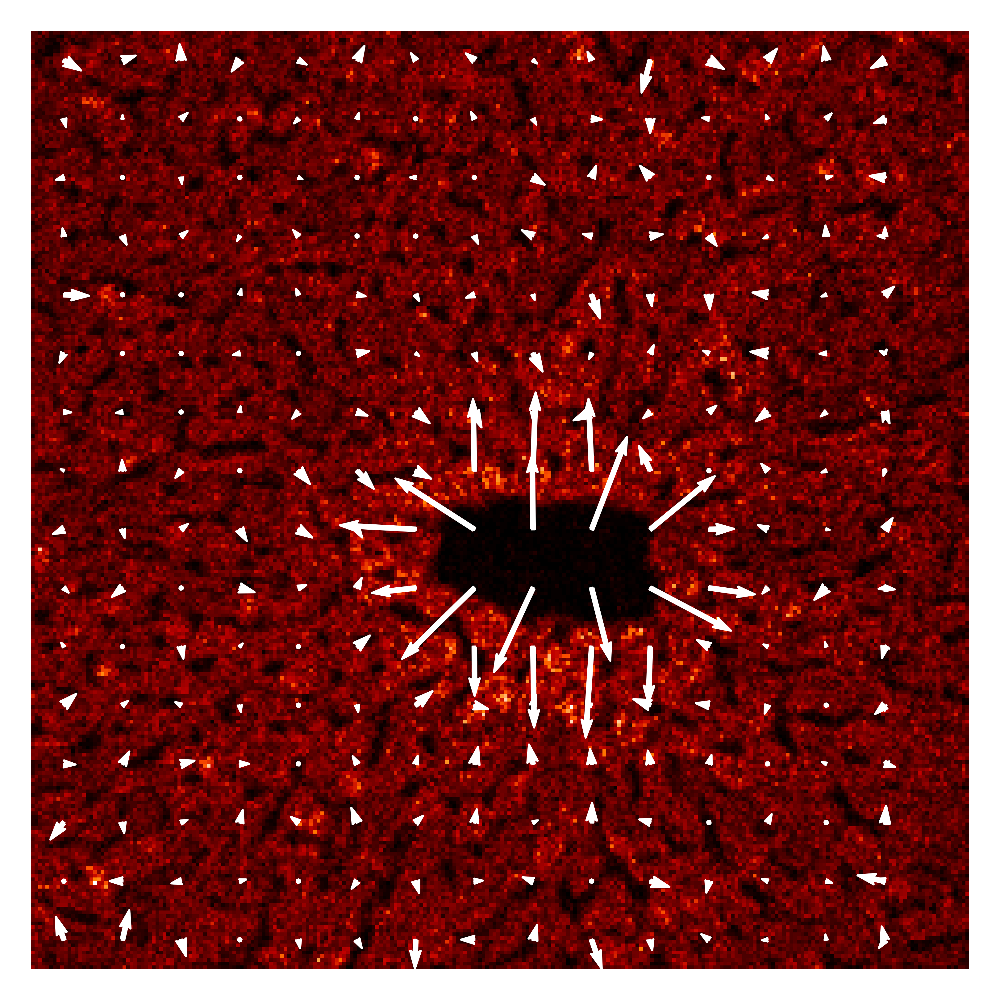

In [20]:
cmp_list = 'gist_heat'
# cmp_list = palettable.colorbrewer.diverging.Spectral_11.mpl_colormap
# cmp_list = heatmap_cmp
IMS_87 = a.uns['IMS'][:,np.where(a.var_names=='87.36')].reshape(256,256)

IMS_87_t = np.rot90(IMS_87,2)
IMS_87_t = np.flip(IMS_87_t,axis=1)

# ax = sc.pl.embedding(a,basis='spatial',color=['87.36'],show=False,color_map=SEAM.settings.heatmap_cmp)
fig,ax = plt.subplots(1,1)
ax.imshow((IMS_87_t),cmap=cmp_list)
# ax.quiver(x_mat,y_mat,dy,dx,scale=5,color='w')
# ax.quiver(x_mat,y_mat,dy,dx,angles='xy',color='w',scale=5,width=5)
ax.quiver(x_mat,y_mat,dy,dx,angles='xy',color='w',scale=5,linewidths=0.5)

ax.axis('off')

(-0.5, 255.5, 255.5, -0.5)

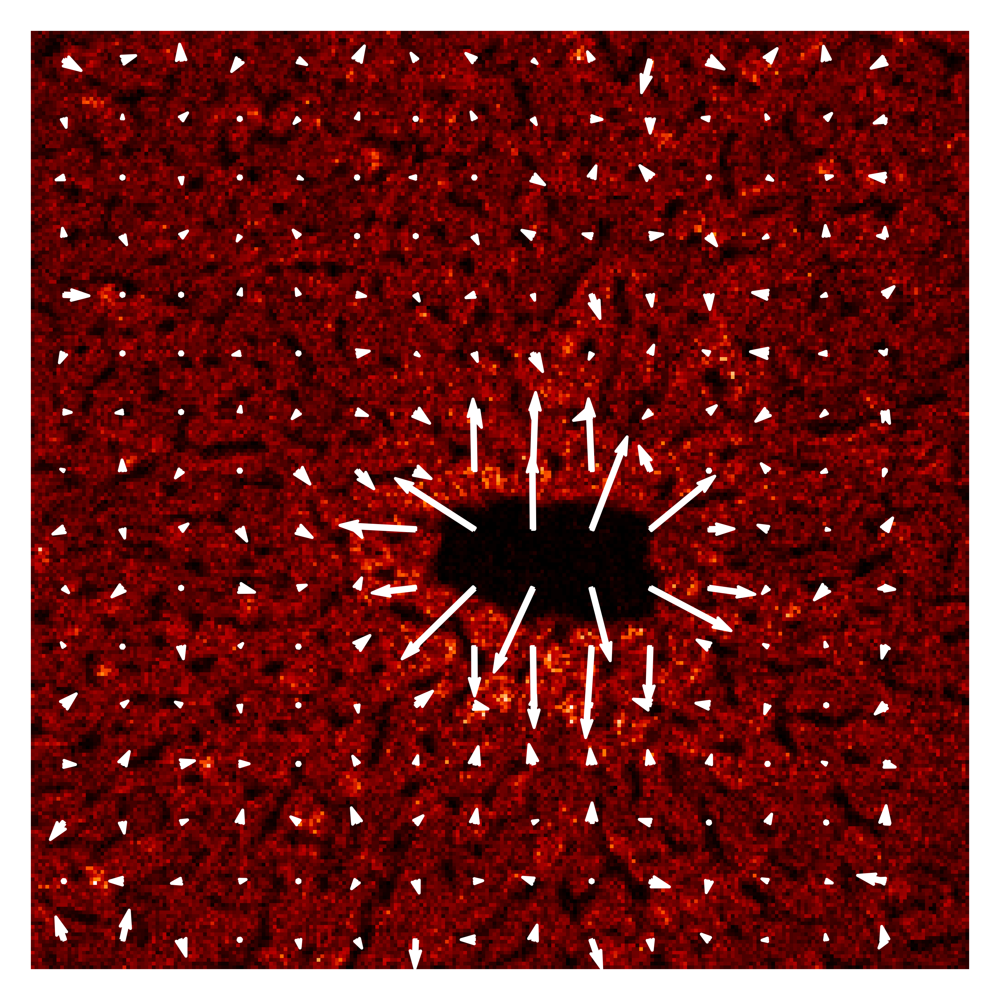

In [21]:
cmp_list = 'gist_heat'
# cmp_list = palettable.colorbrewer.diverging.Spectral_11.mpl_colormap
# cmp_list = heatmap_cmp
IMS_87 = a.uns['IMS'][:,np.where(a.var_names=='87.36')].reshape(256,256)

IMS_87_t = np.rot90(IMS_87,2)
IMS_87_t = np.flip(IMS_87_t,axis=1)

# ax = sc.pl.embedding(a,basis='spatial',color=['87.36'],show=False,color_map=SEAM.settings.heatmap_cmp)
fig,ax = plt.subplots(1,1)
ax.imshow((IMS_87_t),cmap=cmp_list)
# ax.quiver(x_mat,y_mat,dy,dx,scale=5,color='w')
# ax.quiver(x_mat,y_mat,dy,dx,angles='xy',color='w',scale=5,width=5)
ax.quiver(x_mat,y_mat,dy,dx,angles='xy',color='w',scale=5,linewidths=0.7)

ax.axis('off')

### SIMS-flow selected metabolic features (134.48)

In [15]:
n_dot_row = int(np.sqrt(a_grid.shape[0]))

# dpt_mat = np.array(a.obs['dpt_pseudotime'].copy()).reshape(n_dot_row,n_dot_row)
# m = '134.48'
# m = '255.83'
m = '134.48'
dpt_mat = np.array(a_grid[:,m].X).reshape(n_dot_row,n_dot_row)
x_mat = a_grid.obsm['spatial'][:,0].reshape(n_dot_row,n_dot_row)
y_mat = a_grid.obsm['spatial'][:,1].reshape(n_dot_row,n_dot_row)
# x_mat = 255-x_mat
# x_mat = np.flipud(x_mat)
# y_mat = np.flipud(y_mat)
dpt_mat = np.flipud(dpt_mat)
# dpt_mat = np.fliplr(dpt_mat)
dx, dy = np.gradient(dpt_mat)

# y_mat = y_mat.max()-y_mat

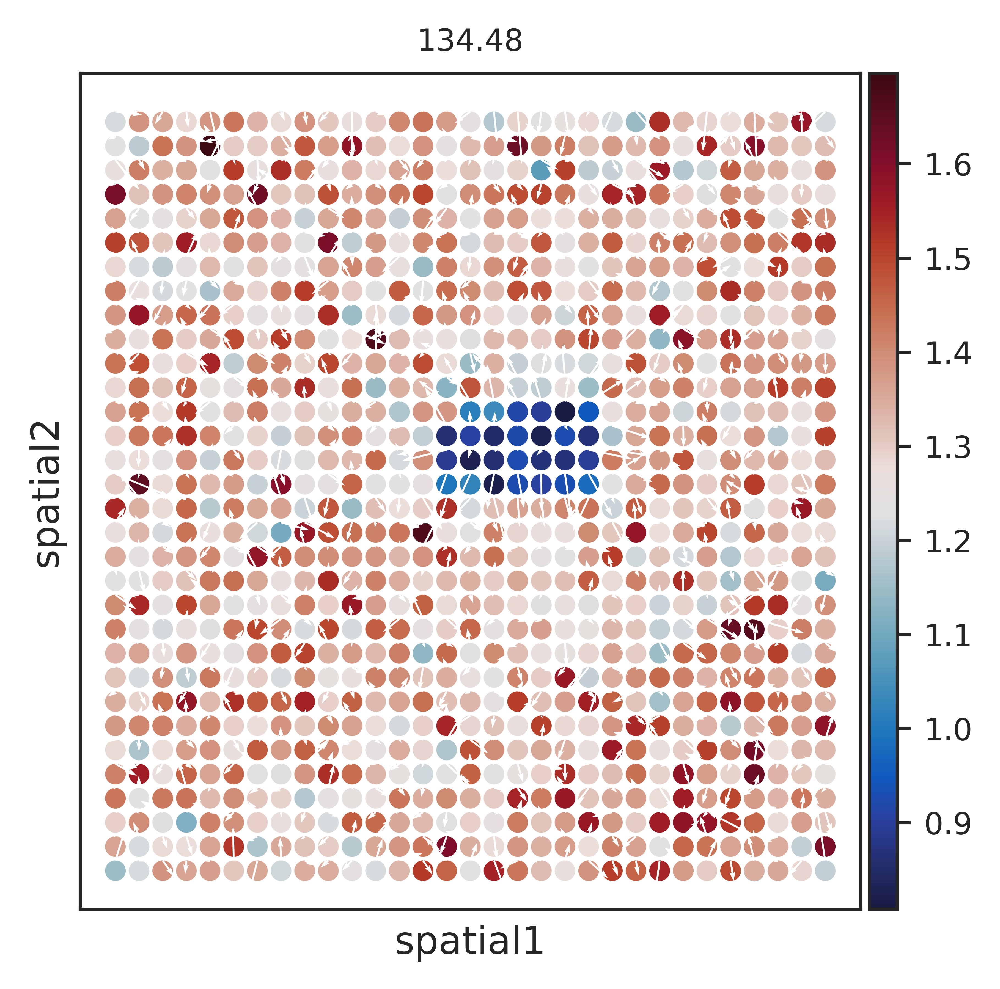

In [16]:
#
# SEAM.settings.heatmap_cmp
# fig,ax = plt.subplots()
ax = sc.pl.embedding(a_grid,basis='spatial',color=[m],show=False,color_map=SEAM.settings.heatmap_cmp)

ax.quiver(x_mat,y_mat,dy,dx,angles='xy',color='w',scale=5)

(-0.5, 255.5, 255.5, -0.5)

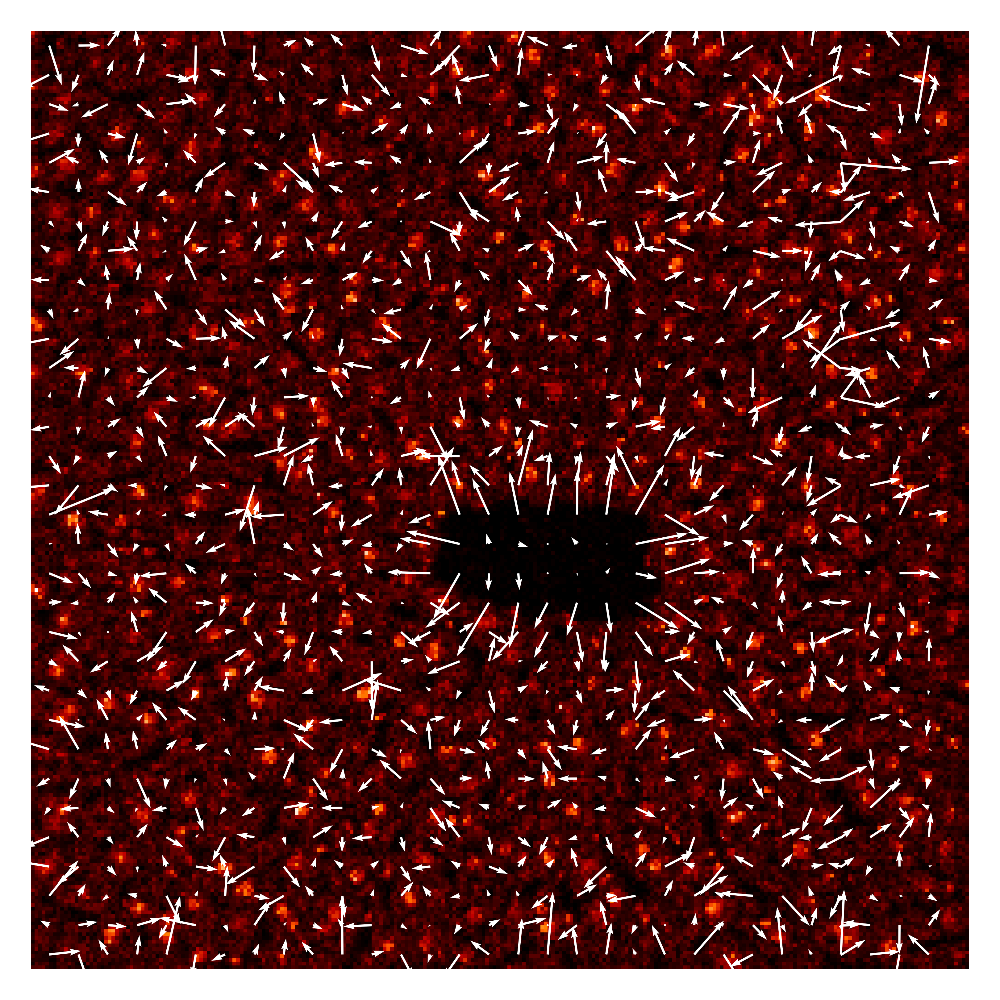

In [17]:
cmp_list = 'gist_heat'
IMS_87 = a.uns['IMS'][:,np.where(a.var_names=='134.48')].reshape(256,256)

IMS_87_t = np.rot90(IMS_87,2)
IMS_87_t = np.flip(IMS_87_t,axis=1)

# ax = sc.pl.embedding(a,basis='spatial',color=['87.36'],show=False,color_map=SEAM.settings.heatmap_cmp)
fig,ax = plt.subplots(1,1)
ax.imshow((IMS_87_t),cmap=cmp_list)
# ax.quiver(x_mat,y_mat,dy,dx,scale=5,color='w')
ax.quiver(x_mat,y_mat,dy,dx,angles='xy',color='w',scale=5)
ax.axis('off')

### SIMS-flow selected metabolic features (101)

In [20]:
n_dot_row = int(np.sqrt(a_grid.shape[0]))

# dpt_mat = np.array(a.obs['dpt_pseudotime'].copy()).reshape(n_dot_row,n_dot_row)
# m = '134.48'
# m = '255.83'
m = '101.41'
dpt_mat = np.array(a_grid[:,m].X).reshape(n_dot_row,n_dot_row)
x_mat = a_grid.obsm['spatial'][:,0].reshape(n_dot_row,n_dot_row)
y_mat = a_grid.obsm['spatial'][:,1].reshape(n_dot_row,n_dot_row)
# x_mat = 255-x_mat
# x_mat = np.flipud(x_mat)
# y_mat = np.flipud(y_mat)
dpt_mat = np.flipud(dpt_mat)
# dpt_mat = np.fliplr(dpt_mat)
dx, dy = np.gradient(dpt_mat)

# y_mat = y_mat.max()-y_mat

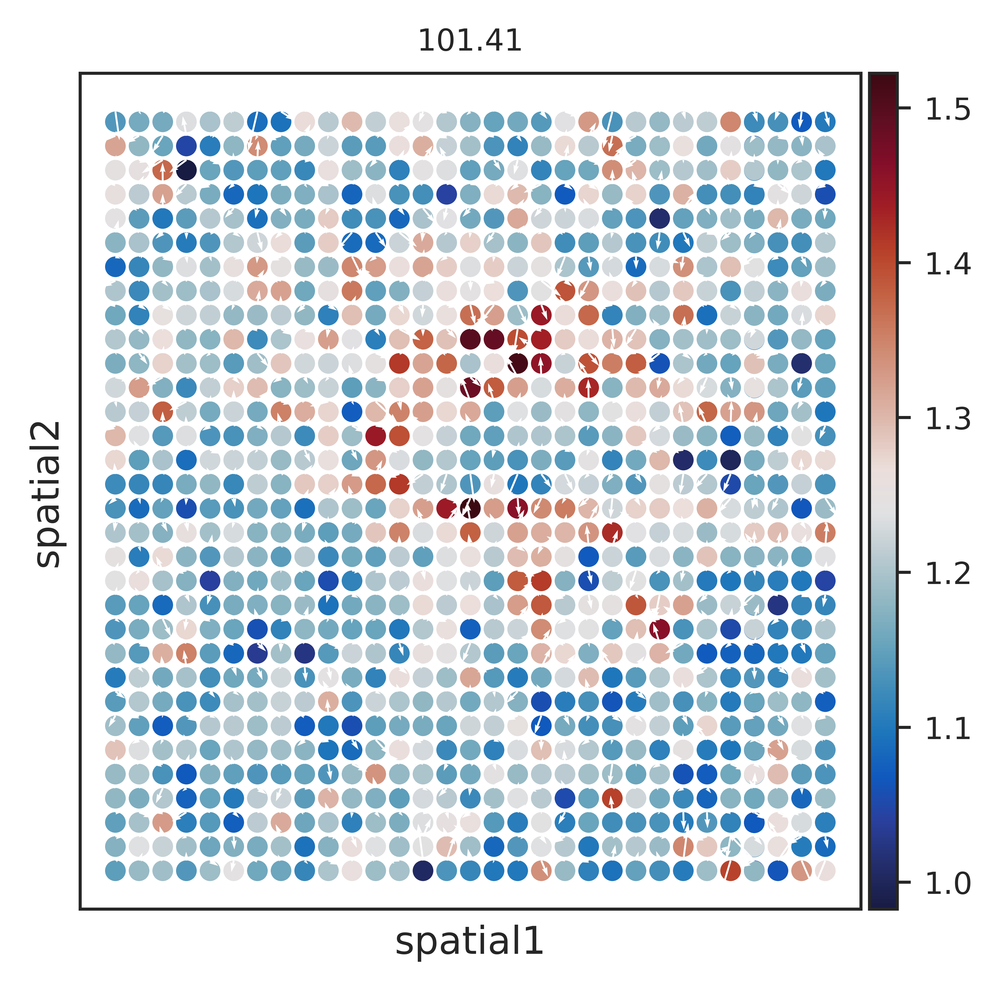

In [21]:
#
# SEAM.settings.heatmap_cmp
# fig,ax = plt.subplots()
ax = sc.pl.embedding(a_grid,basis='spatial',color=[m],show=False,color_map=SEAM.settings.heatmap_cmp)

ax.quiver(x_mat,y_mat,dy,dx,angles='xy',color='w',scale=5)

(-0.5, 255.5, 255.5, -0.5)

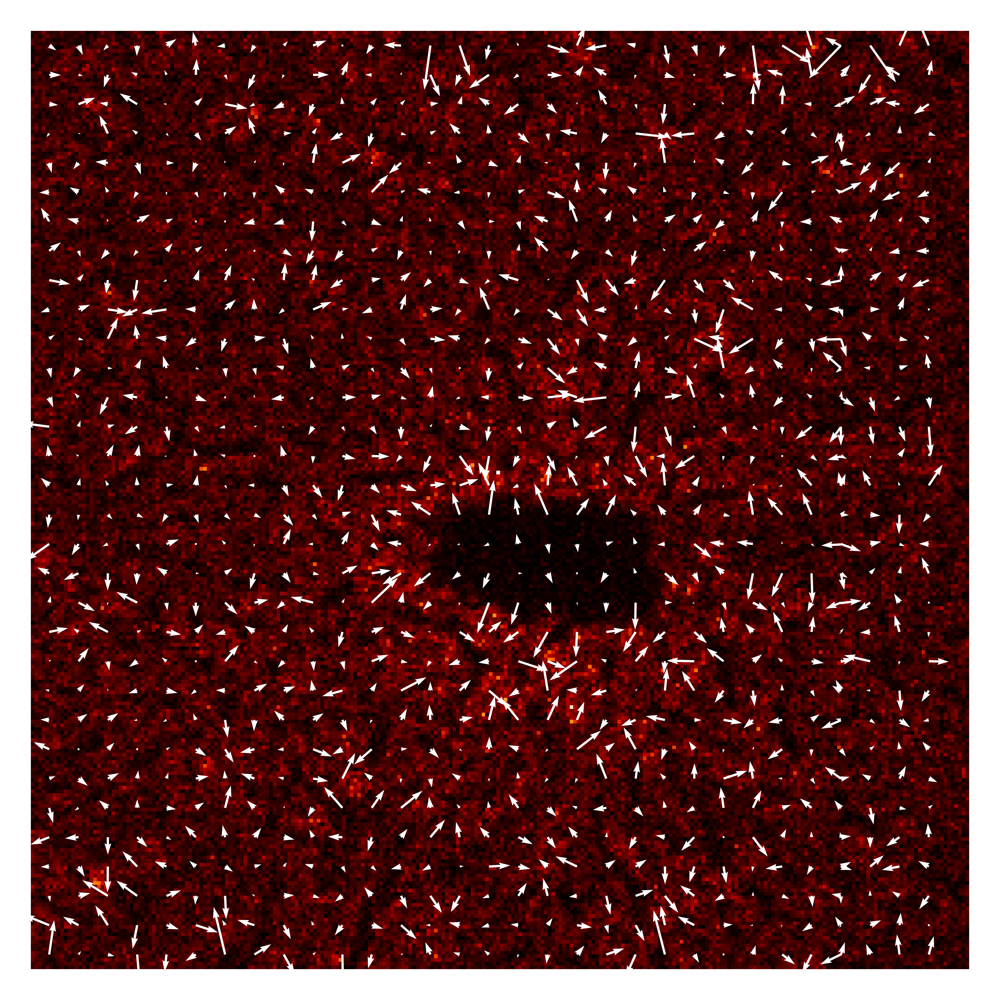

In [23]:
cmp_list = 'gist_heat'
IMS_87 = a.uns['IMS'][:,np.where(a.var_names==m)].reshape(256,256)

IMS_87_t = np.rot90(IMS_87,2)
IMS_87_t = np.flip(IMS_87_t,axis=1)

# ax = sc.pl.embedding(a,basis='spatial',color=['87.36'],show=False,color_map=SEAM.settings.heatmap_cmp)
fig,ax = plt.subplots(1,1)
ax.imshow((IMS_87_t),cmap=cmp_list)
# ax.quiver(x_mat,y_mat,dy,dx,scale=5,color='w')
ax.quiver(x_mat,y_mat,dy,dx,angles='xy',color='w',scale=5)
ax.axis('off')

### multiple m

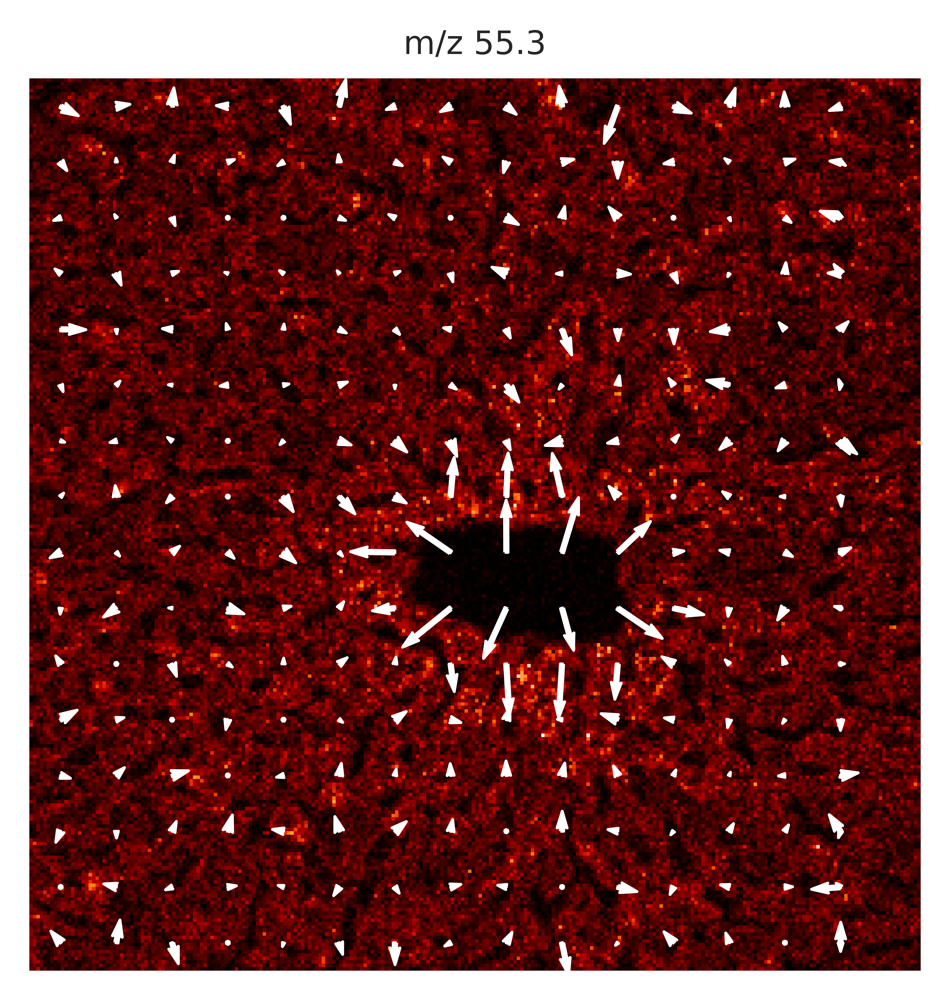

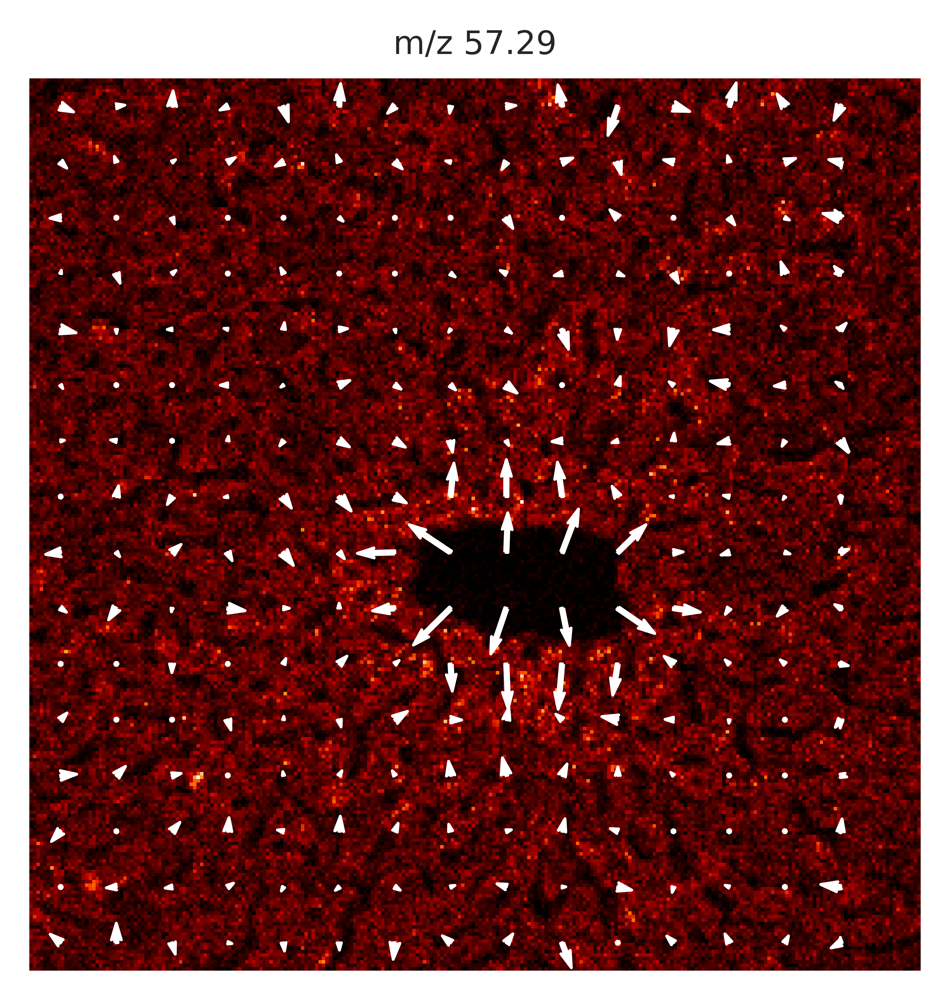

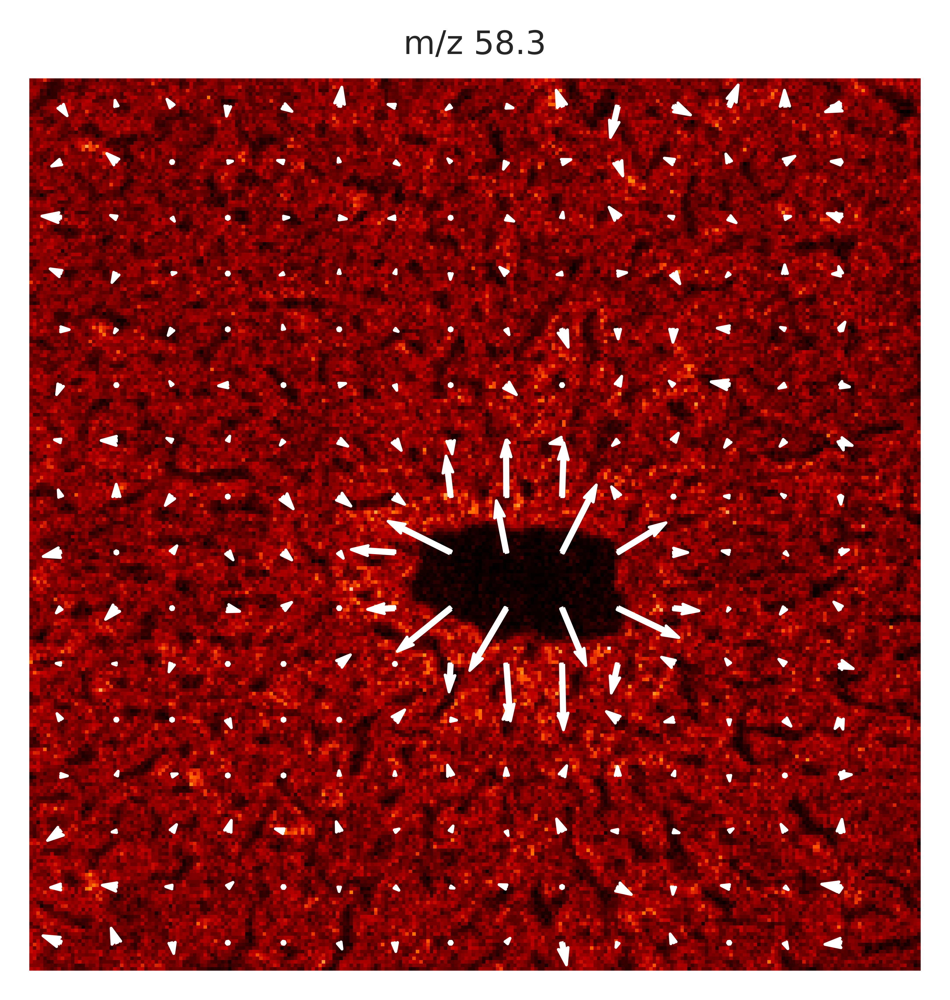

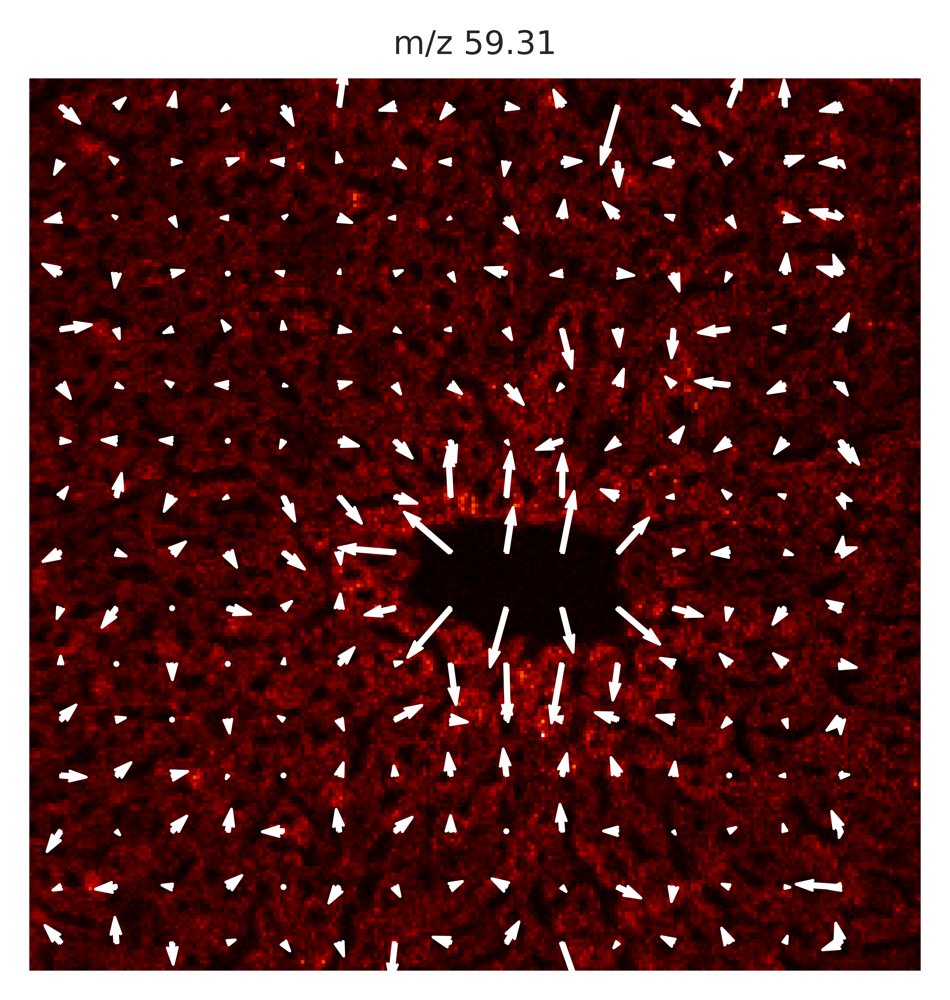

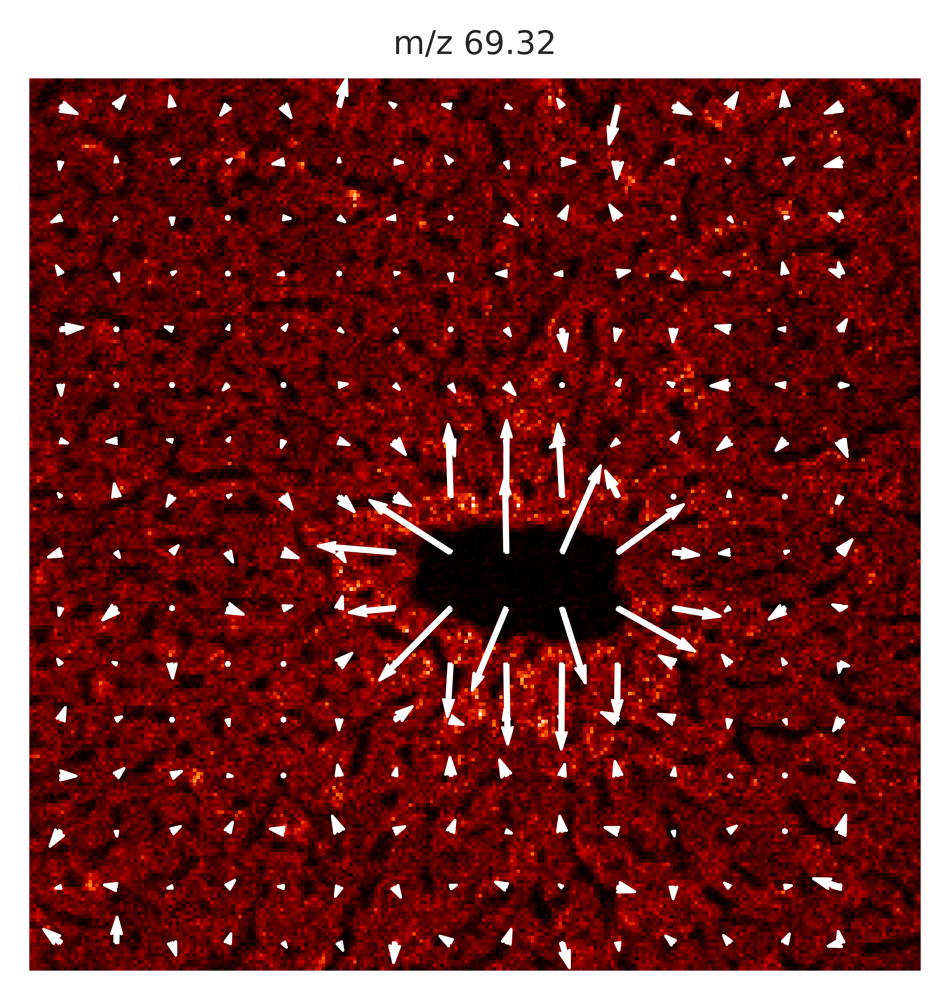

...

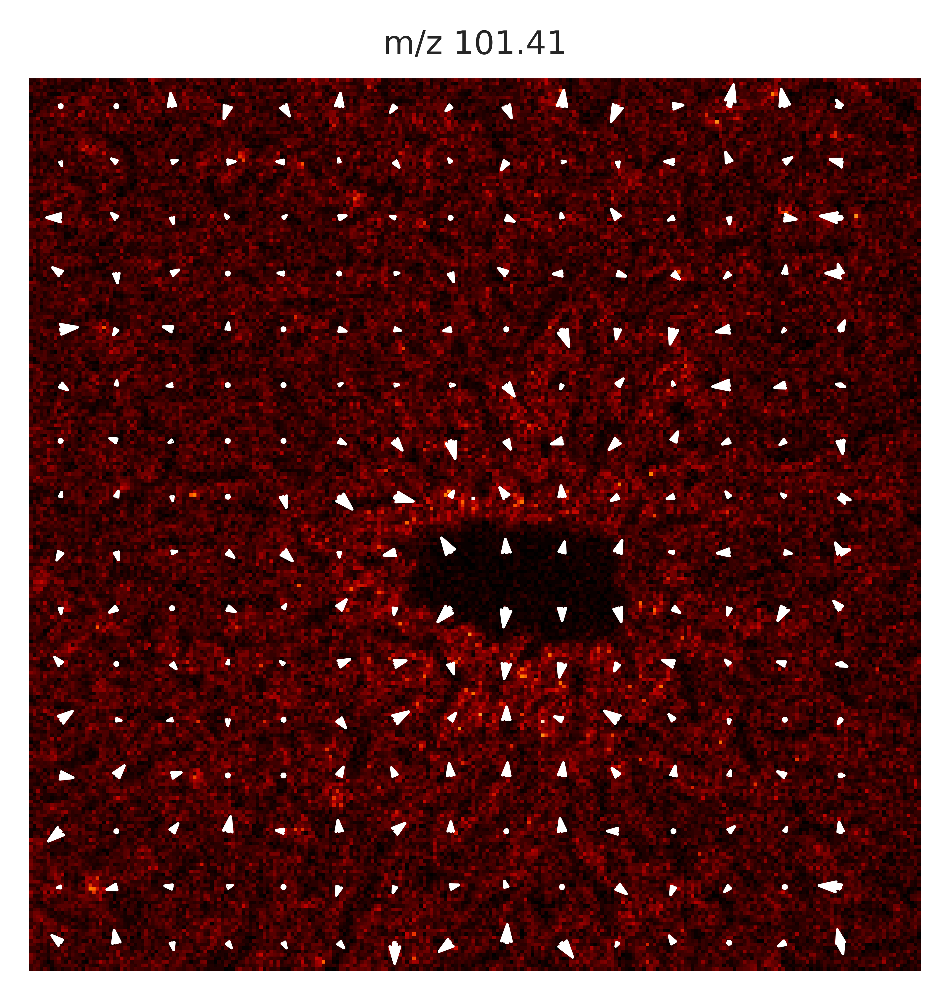

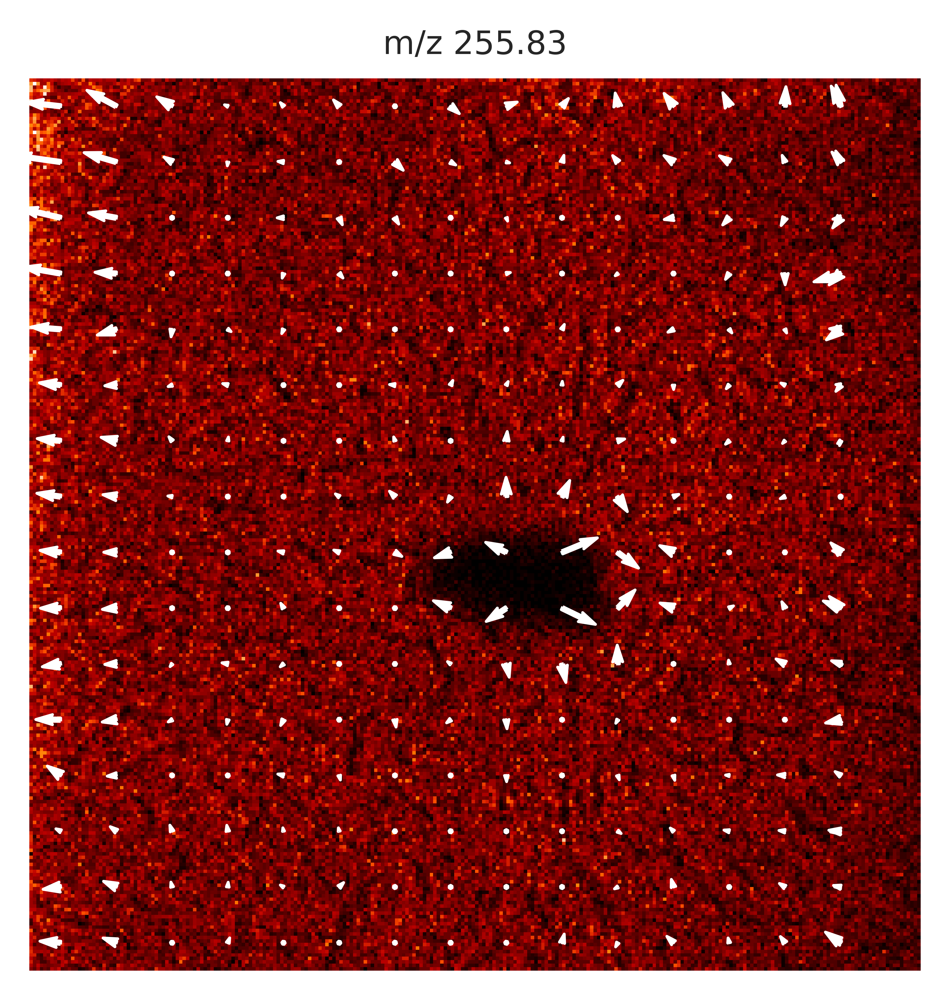

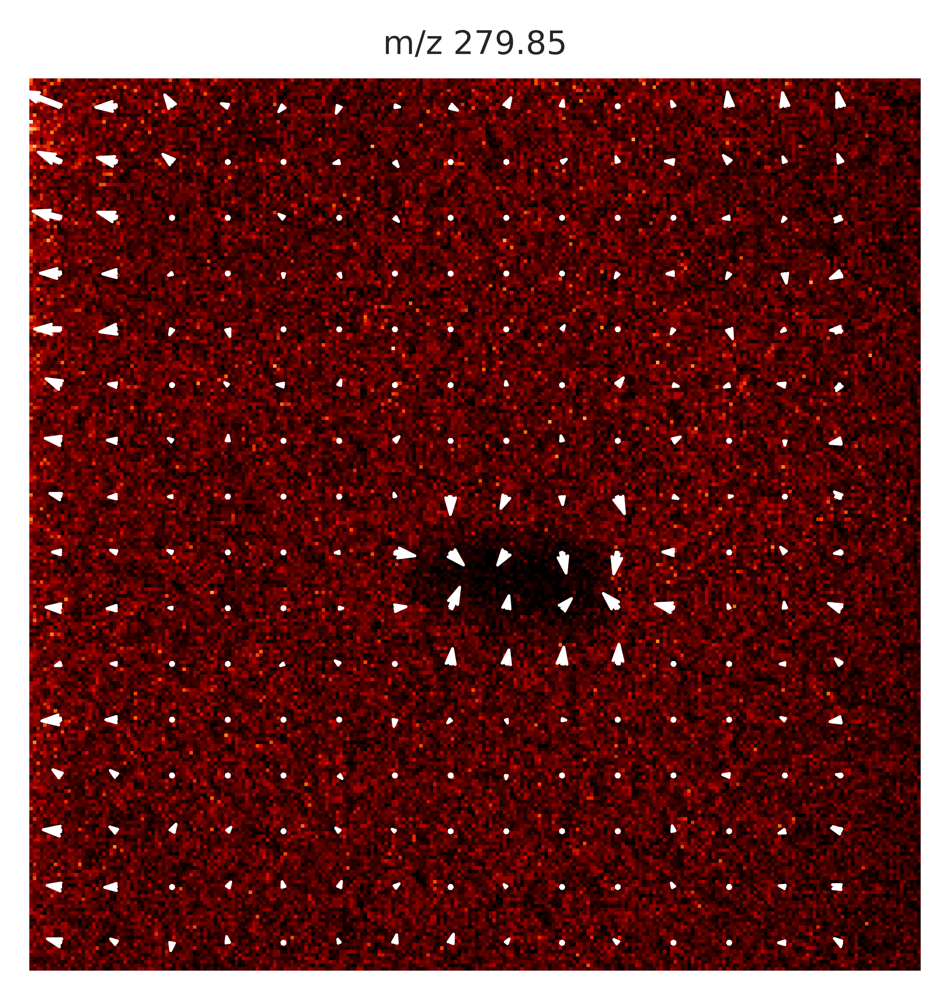

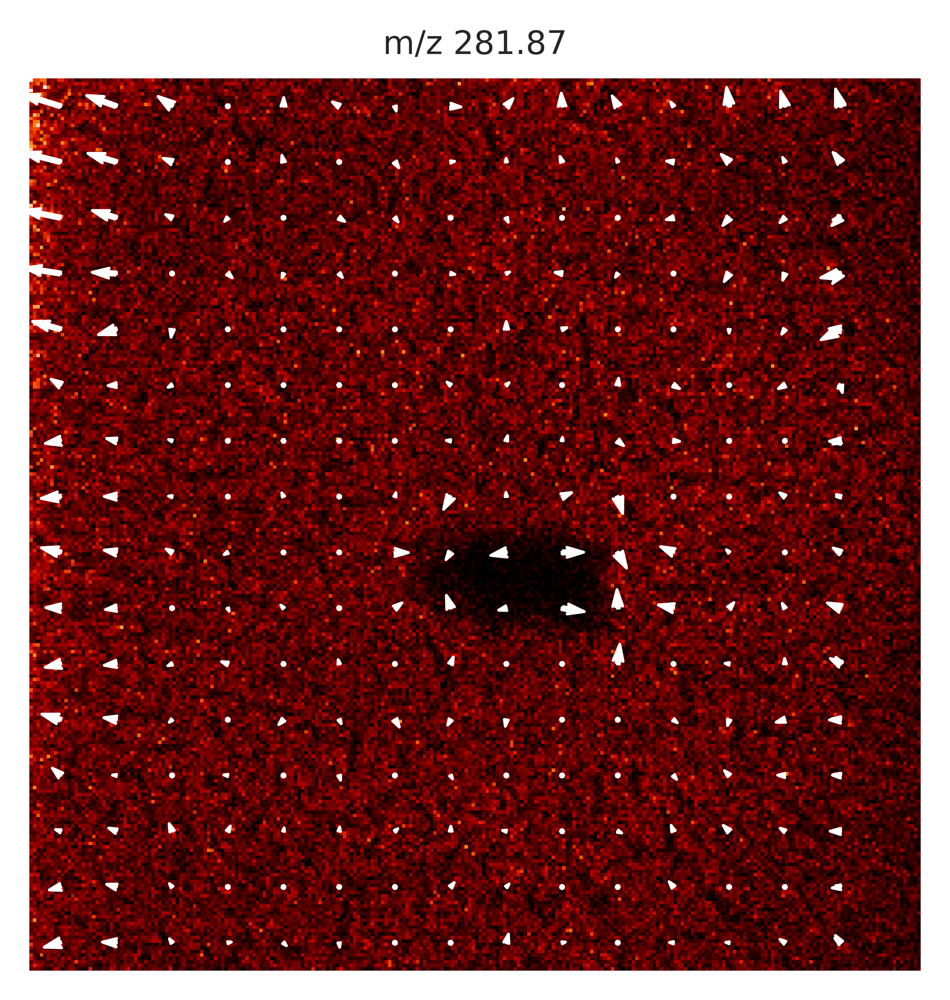

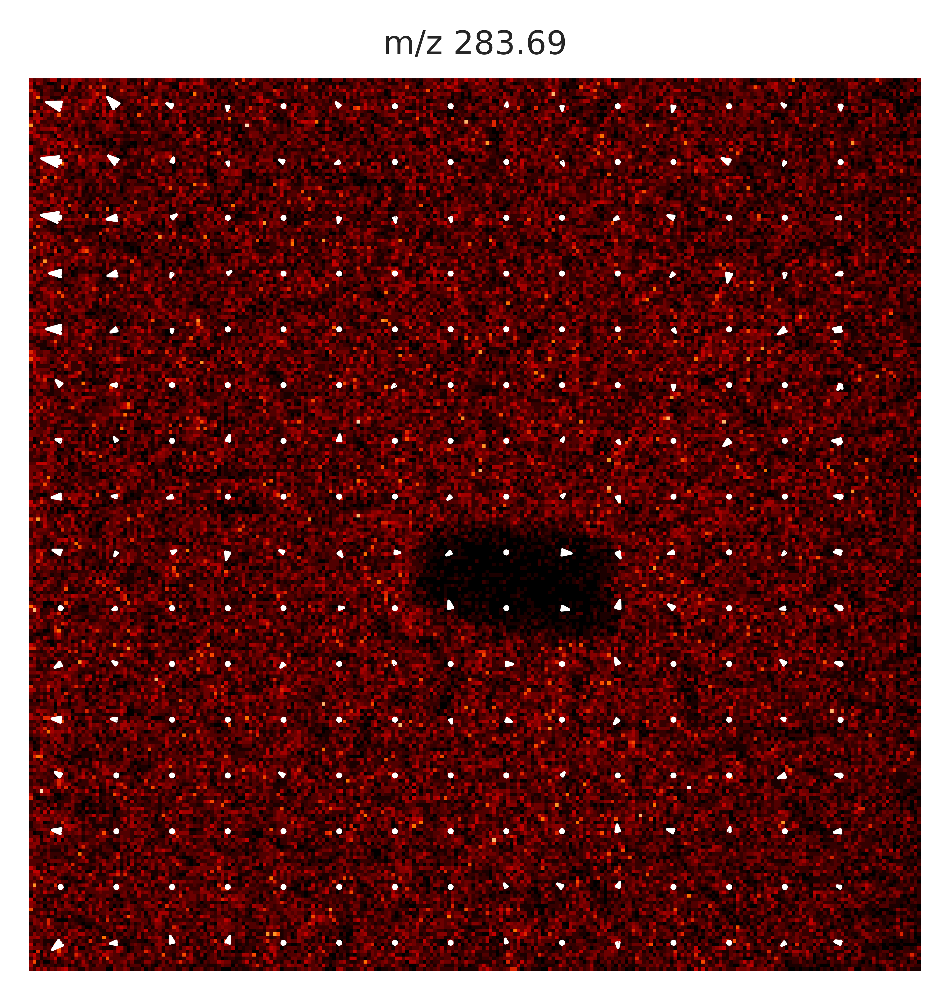

In [32]:
m_list = [
    '55.3','57.29','58.3','59.31','69.32','71.34','73.35','87.36','101.41',
#     '134.48',
    '255.83','279.85','281.87','283.69'

]
for m in m_list:
    save_path = 'grid16/{0}.png'.format(m)
    get_flow_by_m(m,save_path)